<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Certona-Recs" data-toc-modified-id="Certona-Recs-1">Certona Recs</a></span></li><li><span><a href="#ACE-Recs" data-toc-modified-id="ACE-Recs-2">ACE Recs</a></span></li><li><span><a href="#Product-Catalog-Items" data-toc-modified-id="Product-Catalog-Items-3">Product Catalog Items</a></span></li></ul></div>

In [3]:
import os
import numpy as np

from scipy.sparse import coo_matrix, csr_matrix
import gc
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import roc_auc_score

from tqdm.notebook import tqdm
import warnings
warnings.filterwarnings('ignore') 

from IPython.display import display_html, HTML
import pickle
pd.set_option('max_rows',300)
import operator

import os
os.environ["OPENBLAS_NUM_THREADS"] = "1"
import implicit

import multiprocessing
from multiprocessing import  Pool

import json

pd.set_option('display.max_columns', None)

import urllib.request, json 

from IPython.display import Image
from PIL import Image as Img
from PIL import ImageOps
from IPython.core.display import HTML 

### Certona Recs

In [4]:
certona_recs= pd.read_csv('certona_recs_07052021.csv', sep='\t')
print(certona_recs.info())
certona_recs.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 658 entries, 0 to 657
Data columns (total 2 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   product_id  658 non-null    object
 1   recs        658 non-null    object
dtypes: object(2)
memory usage: 10.4+ KB
None


,product_id,recs
0,100070,"A5923, A8601, A8919, A4042"
1,100186,"110488, 109747, 120571, 110610"
2,100188,"100189, 124652, 110488, 100186"
3,100188CA,"124652, 284950, 124651, 110415"
4,100189,"100188, 100186, 100189CA, 110488"


### ACE Recs

In [5]:
#ace_recs= pd.read_csv('product_recommendation_07_07_2021.csv', sep='\t')
ace_recs= pd.read_csv('product_recommendation_with_variant_filter_07_14_2021.csv', sep='\t')
print(ace_recs.info())
ace_recs.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 710 entries, 0 to 709
Data columns (total 2 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   product_id      710 non-null    object
 1   recommendation  710 non-null    object
dtypes: object(2)
memory usage: 11.2+ KB
None


,product_id,recommendation
0,118107D,"118110D,118102D,123396D,118112A,118116D,118104..."
1,124652,"124651,284738,286159,284736,284950,110922,1104..."
2,A0244,"123377,A8914,123372,110610,109747,119346,12336..."
3,WTI0423Z,"100186,100188,100663,100662,100189,120541Z,110..."
4,123364,"123377,123372,A4230,123365,A8914,123843,110610..."


### Product Catalog Items

In [6]:
items = pd.read_csv('catalog_items_with_desc_07062021.csv', sep='\t')
items['id'] = items.id.str.upper()
print(items.info())
items.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 658 entries, 0 to 657
Data columns (total 7 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   id                    658 non-null    object
 1   itemName              658 non-null    object
 2   description           658 non-null    object
 3   brand                 658 non-null    object
 4   categoryId            658 non-null    object
 5   invisibleForUserType  658 non-null    object
 6   variantBaseId         658 non-null    object
dtypes: object(7)
memory usage: 36.1+ KB
None


,id,itemName,description,brand,categoryId,invisibleForUserType,variantBaseId
0,100070,NFS CHOLESTEROL HEALTH 60,Nutrilite Cholesterol Health,F038,248,None,None
1,100186,ESPRING REPL FILTER UV,eSpring Water Purifier Replacement Cartridge w...,F027,237,None,None
2,100188,ESPRING WITH DIVERTER,eSpring UV Water Purifier Above Counter Unit w...,F027,236,None,None
3,100188CA,ESPRING WITH DIVERTER,eSpring UV Water Purifier Above Counter Unit w...,None,None,None,None
4,100189,ESPRING WITH AUX FAUCET,eSpring UV Water Purifier Below Counter Unit w...,F027,236,None,None


In [7]:
def display_product_recs(df, num_display, num_start):
    i = 0
    num_display = int(num_display)
    num_start = int(num_start)
    for index, row in certona_recs.iterrows():
        i+=1
        if i >= num_start:
            certona_product_id = row['product_id']
            certona_recs_list = row['recs']
            certona_product_id_image_path = str("./images/"+certona_product_id+".jpg")
            certona_product_id_name = items[items['id'] == certona_product_id]
            #print(certona_recs_list)

            ace_recs_row = ace_recs[ace_recs['product_id'] == certona_product_id]
            ace_recs_list = ace_recs_row['recommendation'].tolist()
            ace_recs_string = ",".join(ace_recs_list)
            #print(','.join(ace_recs_string.split(',')[0:4]))
            seed_product_image = []
            certona_recs_images = []
            ace_recs_images = []
            size = 345,345

            try:
                seed_product= Img.open(str("./images/"+certona_product_id+".jpg")).resize((size))
                seed_product_image.append(seed_product)
                for certona_rec in certona_recs_list.split(','):
                    certona_rec = certona_rec.strip()
                    #print(certona_rec)
                    certona_recs_images.append(Img.open(str("./images/"+certona_rec+".jpg")))

                for ace_rec in ace_recs_string.split(',')[0:4]:
                    ace_rec = ace_rec.strip()
                    #print(ace_rec)
                    ace_recs_images.append(Img.open(str("./images/"+ace_rec+".jpg")))

            except Exception as e:
                print(str(e))
                continue
            display(HTML('<table border-top: 1px solid #8c8b8b;>'))
            display(HTML('<hr border-top: 1px solid #8c8b8b;>'))
            display(HTML('<h3 align = "center">' +str(items.loc[items['id'] == certona_product_id, 'description'].item()) +'</h3>')) 
            display(HTML('<h5 align = "center" >Item #: ' +certona_product_id +', Category id:' + str(items.loc[items['id'] == certona_product_id, 'categoryId'].item())+' </h5>')) 
            display(Image(url=certona_product_id_image_path, width = 345, height = 345))
            #display(Img.fromarray(np.concatenate((seed_product_image), axis=1)))
            display(HTML('<h2 align = "center">Certona Recommedantions</h2>')) 
            display(HTML('<h5 align = "center" >Item # ' + certona_recs_list +' </h5>')) 
            display(Img.fromarray(np.concatenate((certona_recs_images), axis=1)))
            display(HTML('<h2 align = "center">ACE Recommedantions</h2>')) 
            display(HTML('<h5 align = "center" >Item #: ' +','.join(ace_recs_string.split(',')[0:4])+' </h5>')) 
            display(Img.fromarray(np.concatenate((ace_recs_images), axis=1)))
            display(HTML('<br><br>'))
            display(HTML('</table>'))
            i+=1
            if i >= (num_start +num_display):
                print('Last Item #: ', i)
                break

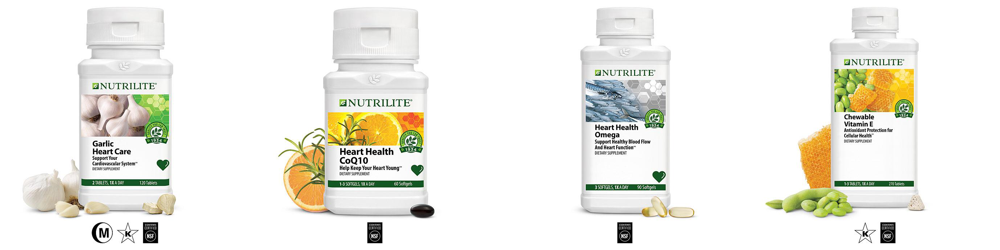

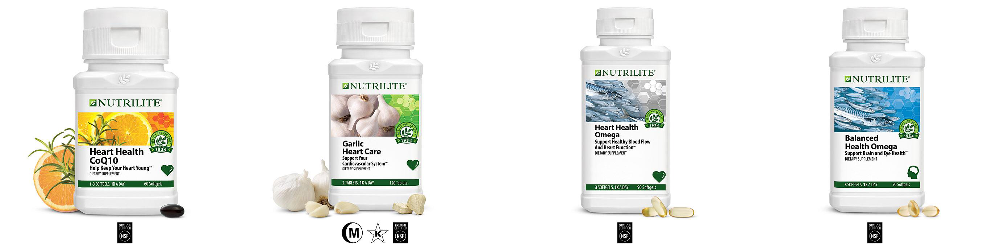

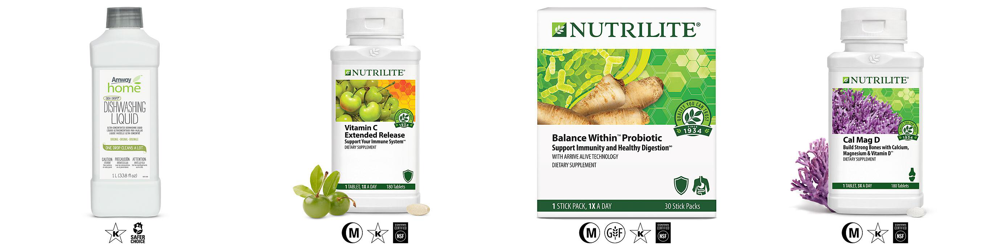

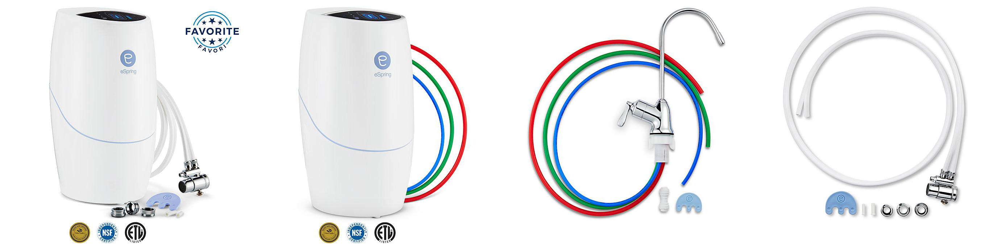

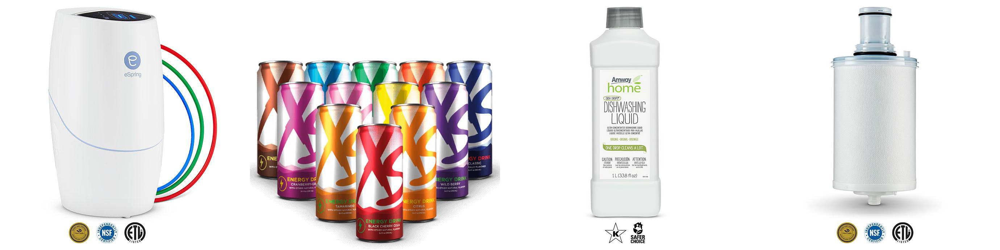

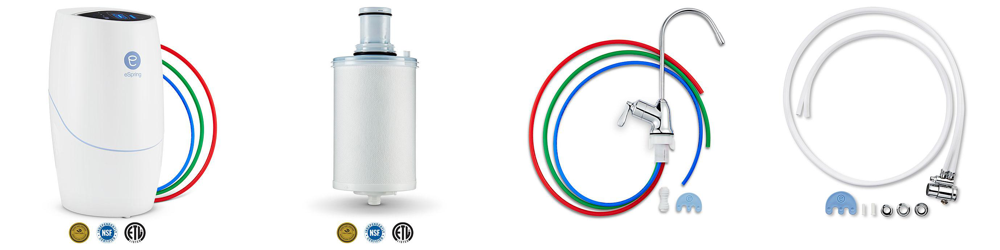

[Errno 2] No such file or directory: './images/100188CA.jpg'
[Errno 2] No such file or directory: './images/100189CA.jpg'
[Errno 2] No such file or directory: './images/100189CA.jpg'


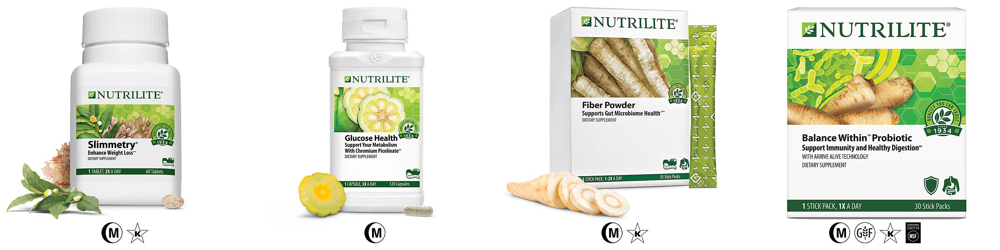

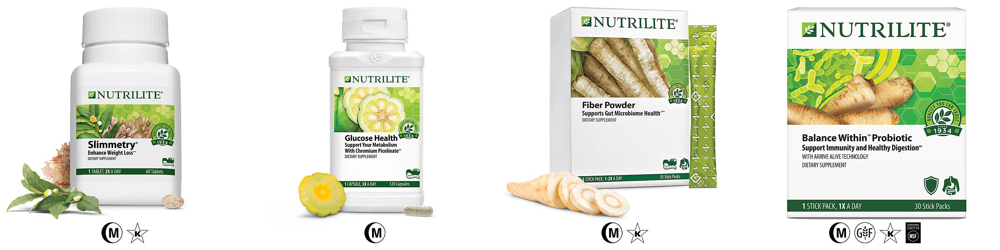

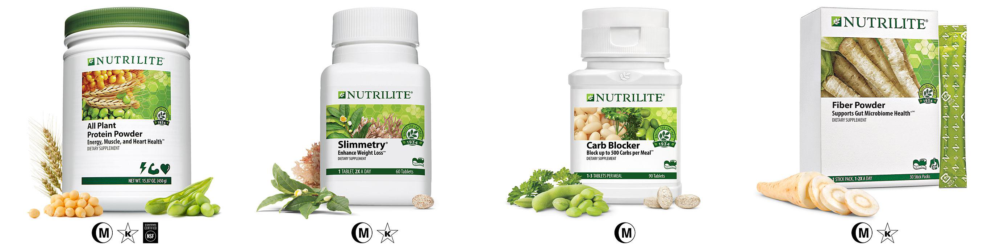

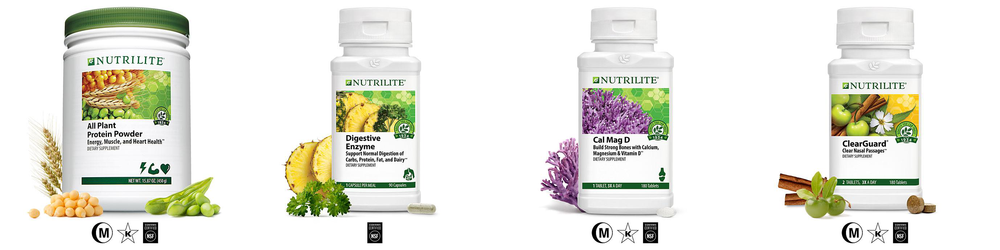

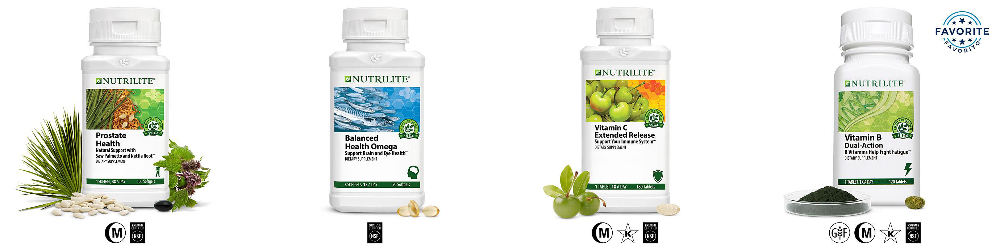

...

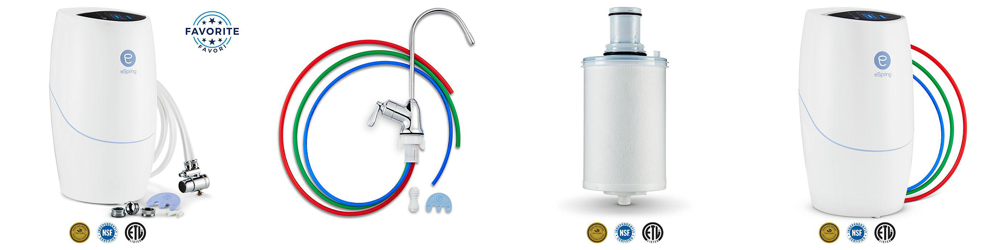

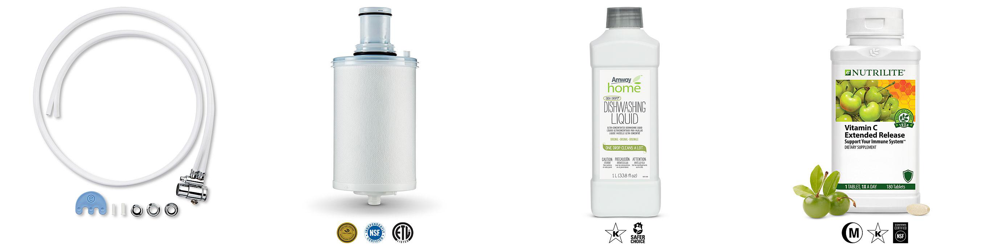

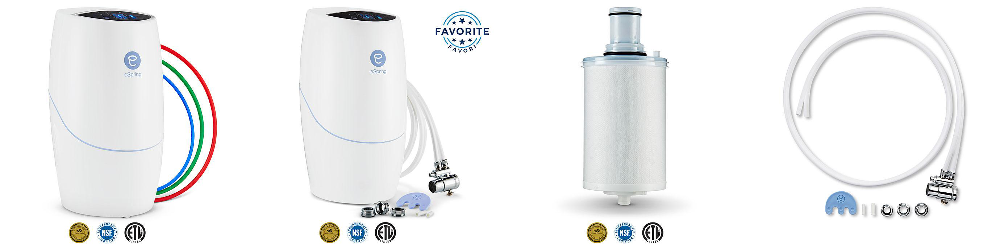

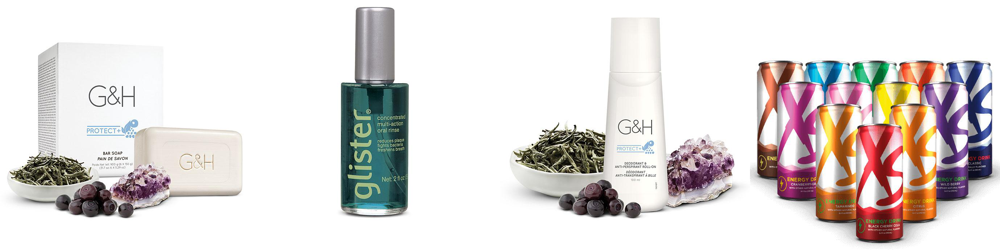

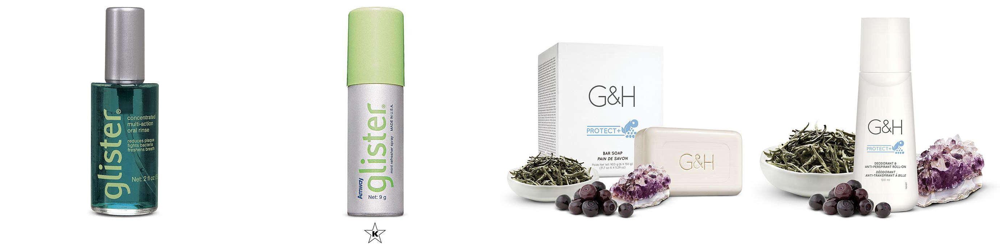

Last Item #:  21


In [9]:
display_product_recs(certona_recs, 20, 1)
